In [2]:
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import altair as alt

bikes = pd.read_csv('https://raw.githubusercontent.com/byui-cse/cse450-course/master/data/bikes.csv')

In [3]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Activation, Dense
from tensorflow.keras.optimizers import Adam

In [4]:
bikes.head(5)

,dteday,season,hr,holiday,workingday,weathersit,hum,windspeed,temp_c,feels_like_c,casual,registered
0,1/1/11,1,0,0,0,1,0.81,0,3.28,3.0014,3,13
1,1/1/11,1,1,0,0,1,0.80,0,2.34,1.9982,8,32
2,1/1/11,1,2,0,0,1,0.80,0,2.34,1.9982,5,27
3,1/1/11,1,3,0,0,1,0.75,0,3.28,3.0014,3,10
4,1/1/11,1,4,0,0,1,0.75,0,3.28,3.0014,0,1


In [5]:
bikes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17379 entries, 0 to 17378
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   dteday        17379 non-null  object 
 1   season        17379 non-null  int64  
 2   hr            17379 non-null  int64  
 3   holiday       17379 non-null  int64  
 4   workingday    17379 non-null  int64  
 5   weathersit    17379 non-null  int64  
 6   hum           17379 non-null  float64
 7   windspeed     17379 non-null  int64  
 8   temp_c        17379 non-null  float64
 9   feels_like_c  17379 non-null  float64
 10  casual        17379 non-null  int64  
 11  registered    17379 non-null  int64  
dtypes: float64(3), int64(8), object(1)
memory usage: 1.6+ MB


In [6]:
bikes.isna().sum()

dteday          0
season          0
hr              0
holiday         0
workingday      0
weathersit      0
hum             0
windspeed       0
temp_c          0
feels_like_c    0
casual          0
registered      0
dtype: int64

In [7]:
#season : season (1:winter, 2:spring, 3:summer, 4:fall) 

def get_season(s):
  if s == 1:
    return "winter"
  elif s == 2:
    return "spring"
  elif s == 3:
    return "summer"
  else:
    return "fall"

def winter_yes(s):
  if s == 1:
    return "yes"
  else:
    return "no"

bikes["season_type"] = bikes.season.apply(get_season)

bikes["winter"] = bikes.season.apply(winter_yes)

bikes.head(5)

,dteday,season,hr,holiday,workingday,weathersit,hum,windspeed,temp_c,feels_like_c,casual,registered,season_type,winter
0,1/1/11,1,0,0,0,1,0.81,0,3.28,3.0014,3,13,winter,yes
1,1/1/11,1,1,0,0,1,0.80,0,2.34,1.9982,8,32,winter,yes
2,1/1/11,1,2,0,0,1,0.80,0,2.34,1.9982,5,27,winter,yes
3,1/1/11,1,3,0,0,1,0.75,0,3.28,3.0014,3,10,winter,yes
4,1/1/11,1,4,0,0,1,0.75,0,3.28,3.0014,0,1,winter,yes


In [8]:
bikes.columns

Index(['dteday', 'season', 'hr', 'holiday', 'workingday', 'weathersit', 'hum',
       'windspeed', 'temp_c', 'feels_like_c', 'casual', 'registered',
       'season_type', 'winter'],
      dtype='object')

In [9]:
def weathersit_three(w):
  if w == 3:
    return "yes"
  else:
    return "no"

bikes["weathersit_3"] = bikes.weathersit.apply(weathersit_three)

In [10]:
bikes = pd.get_dummies(bikes, columns=['season_type', 'weathersit', 'weathersit_3'])

bikes.head(5)

,dteday,season,hr,holiday,workingday,hum,windspeed,temp_c,feels_like_c,casual,registered,winter,season_type_fall,season_type_spring,season_type_summer,season_type_winter,weathersit_1,weathersit_2,weathersit_3,weathersit_4,weathersit_3_no,weathersit_3_yes
0,1/1/11,1,0,0,0,0.81,0,3.28,3.0014,3,13,yes,0,0,0,1,1,0,0,0,1,0
1,1/1/11,1,1,0,0,0.80,0,2.34,1.9982,8,32,yes,0,0,0,1,1,0,0,0,1,0
2,1/1/11,1,2,0,0,0.80,0,2.34,1.9982,5,27,yes,0,0,0,1,1,0,0,0,1,0
3,1/1/11,1,3,0,0,0.75,0,3.28,3.0014,3,10,yes,0,0,0,1,1,0,0,0,1,0
4,1/1/11,1,4,0,0,0.75,0,3.28,3.0014,0,1,yes,0,0,0,1,1,0,0,0,1,0


In [11]:
bikes["total_rented"] = bikes.casual + bikes.registered

In [12]:
bikes.columns

Index(['dteday', 'season', 'hr', 'holiday', 'workingday', 'hum', 'windspeed',
       'temp_c', 'feels_like_c', 'casual', 'registered', 'winter',
       'season_type_fall', 'season_type_spring', 'season_type_summer',
       'season_type_winter', 'weathersit_1', 'weathersit_2', 'weathersit_3',
       'weathersit_4', 'weathersit_3_no', 'weathersit_3_yes', 'total_rented'],
      dtype='object')

<BarContainer object of 17379 artists>

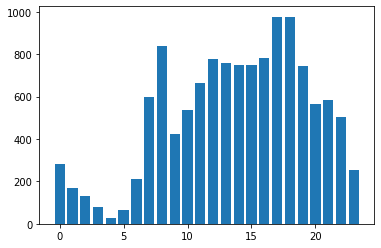

In [13]:

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

plt.bar(bikes['hr'], bikes['total_rented'],align='center')


In [14]:
total_by_hr = bikes.groupby(['hr'])['total_rented'].sum().reset_index()

total_by_hr.head(2)

,hr,total_rented
0,0,39130
1,1,24164


<BarContainer object of 24 artists>

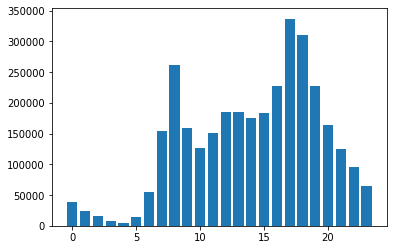

In [15]:
plt.bar(total_by_hr['hr'], total_by_hr['total_rented'],align='center')

In [16]:
def after_five(h):
  if h > 5:
    return "yes"
  else:
    return "no"

bikes['after_5'] = bikes.hr.apply(after_five)

bikes.columns

Index(['dteday', 'season', 'hr', 'holiday', 'workingday', 'hum', 'windspeed',
       'temp_c', 'feels_like_c', 'casual', 'registered', 'winter',
       'season_type_fall', 'season_type_spring', 'season_type_summer',
       'season_type_winter', 'weathersit_1', 'weathersit_2', 'weathersit_3',
       'weathersit_4', 'weathersit_3_no', 'weathersit_3_yes', 'total_rented',
       'after_5'],
      dtype='object')

In [17]:
bikes.head(5)

,dteday,season,hr,holiday,workingday,hum,windspeed,temp_c,feels_like_c,casual,registered,winter,season_type_fall,season_type_spring,season_type_summer,season_type_winter,weathersit_1,weathersit_2,weathersit_3,weathersit_4,weathersit_3_no,weathersit_3_yes,total_rented,after_5
0,1/1/11,1,0,0,0,0.81,0,3.28,3.0014,3,13,yes,0,0,0,1,1,0,0,0,1,0,16,no
1,1/1/11,1,1,0,0,0.80,0,2.34,1.9982,8,32,yes,0,0,0,1,1,0,0,0,1,0,40,no
2,1/1/11,1,2,0,0,0.80,0,2.34,1.9982,5,27,yes,0,0,0,1,1,0,0,0,1,0,32,no
3,1/1/11,1,3,0,0,0.75,0,3.28,3.0014,3,10,yes,0,0,0,1,1,0,0,0,1,0,13,no
4,1/1/11,1,4,0,0,0.75,0,3.28,3.0014,0,1,yes,0,0,0,1,1,0,0,0,1,0,1,no


In [18]:
from sklearn import preprocessing

In [19]:
bikes["temp_norm"] = preprocessing.normalize(bikes[['temp_c']])

bikes.head(2)

,dteday,season,hr,holiday,workingday,hum,windspeed,temp_c,feels_like_c,casual,registered,winter,season_type_fall,season_type_spring,season_type_summer,season_type_winter,weathersit_1,weathersit_2,weathersit_3,weathersit_4,weathersit_3_no,weathersit_3_yes,total_rented,after_5,temp_norm
0,1/1/11,1,0,0,0,0.81,0,3.28,3.0014,3,13,yes,0,0,0,1,1,0,0,0,1,0,16,no,1.0
1,1/1/11,1,1,0,0,0.80,0,2.34,1.9982,8,32,yes,0,0,0,1,1,0,0,0,1,0,40,no,1.0


In [20]:
print(bikes.temp_norm.max())
print(bikes.temp_norm.min())

1.0
-1.0


In [21]:
import numpy as np
quartiles = np.percentile(bikes.temp_norm, [25, 50, 75])

print('Q1: %.3f' % quartiles[0])
print('Median: %.3f' % quartiles[1])
print('Q3: %.3f' % quartiles[2])


Q1: 1.000
Median: 1.000
Q3: 1.000


In [22]:
bikes["feels_norm"] = preprocessing.normalize(bikes[['feels_like_c']])
bikes["wind_norm"] = preprocessing.normalize(bikes[['windspeed']])
bikes.columns

Index(['dteday', 'season', 'hr', 'holiday', 'workingday', 'hum', 'windspeed',
       'temp_c', 'feels_like_c', 'casual', 'registered', 'winter',
       'season_type_fall', 'season_type_spring', 'season_type_summer',
       'season_type_winter', 'weathersit_1', 'weathersit_2', 'weathersit_3',
       'weathersit_4', 'weathersit_3_no', 'weathersit_3_yes', 'total_rented',
       'after_5', 'temp_norm', 'feels_norm', 'wind_norm'],
      dtype='object')

In [23]:
#dteday 
import datetime

bikes['dteday'] = pd.to_datetime(bikes.dteday)

bikes['year'] = pd.DatetimeIndex(bikes['dteday']).year
bikes['month'] = pd.DatetimeIndex(bikes['dteday']).month
bikes['weekday_n'] = bikes['dteday'].dt.dayofweek

bikes.head(2)

,dteday,season,hr,holiday,workingday,hum,windspeed,temp_c,feels_like_c,casual,registered,winter,season_type_fall,season_type_spring,season_type_summer,season_type_winter,weathersit_1,weathersit_2,weathersit_3,weathersit_4,weathersit_3_no,weathersit_3_yes,total_rented,after_5,temp_norm,feels_norm,wind_norm,year,month,weekday_n
0,2011-01-01,1,0,0,0,0.81,0,3.28,3.0014,3,13,yes,0,0,0,1,1,0,0,0,1,0,16,no,1.0,1.0,0.0,2011,1,5
1,2011-01-01,1,1,0,0,0.80,0,2.34,1.9982,8,32,yes,0,0,0,1,1,0,0,0,1,0,40,no,1.0,1.0,0.0,2011,1,5


In [24]:
bikes.year.min()

2011

In [25]:
bikes.year.max()

2012

In [26]:
bikes.weekday_n.max()

6

In [27]:
bikes.weekday_n.min()

0

In [28]:
print(bikes.month.max())
print(bikes.month.min())

12
1


In [29]:
def month_name(m):
  if m == 1:
    return "January"
  elif m == 2:
    return "February"
  elif m == 3:
    return "March"
  elif m == 4:
    return "April"
  elif m == 5:
    return "May"
  elif m == 6:
    return "June"
  elif m == 7:
    return "July"
  elif m == 8:
    return "August"
  elif m == 9:
    return "September"
  elif m == 10:
    return "October"
  elif m == 11:
    return "November"
  else:
    return "December"


def weekday_name(w):
  if w == 0:
    return "Sunday"
  elif w == 1:
    return "Monday"
  elif w ==2:
    return "Tuesday"
  elif w == 3:
    return "Wednesday"
  elif w == 4:
    return "Thursday"
  elif w == 5:
    return "Friday"
  else:
    return "Saturday"

bikes["month_n"] = bikes.month.apply(month_name)
bikes["weekday_n"] = bikes.weekday_n.apply(weekday_name)

bikes.columns

Index(['dteday', 'season', 'hr', 'holiday', 'workingday', 'hum', 'windspeed',
       'temp_c', 'feels_like_c', 'casual', 'registered', 'winter',
       'season_type_fall', 'season_type_spring', 'season_type_summer',
       'season_type_winter', 'weathersit_1', 'weathersit_2', 'weathersit_3',
       'weathersit_4', 'weathersit_3_no', 'weathersit_3_yes', 'total_rented',
       'after_5', 'temp_norm', 'feels_norm', 'wind_norm', 'year', 'month',
       'weekday_n', 'month_n'],
      dtype='object')

In [30]:
bikes.head(4)

,dteday,season,hr,holiday,workingday,hum,windspeed,temp_c,feels_like_c,casual,registered,winter,season_type_fall,season_type_spring,season_type_summer,season_type_winter,weathersit_1,weathersit_2,weathersit_3,weathersit_4,weathersit_3_no,weathersit_3_yes,total_rented,after_5,temp_norm,feels_norm,wind_norm,year,month,weekday_n,month_n
0,2011-01-01,1,0,0,0,0.81,0,3.28,3.0014,3,13,yes,0,0,0,1,1,0,0,0,1,0,16,no,1.0,1.0,0.0,2011,1,Friday,January
1,2011-01-01,1,1,0,0,0.80,0,2.34,1.9982,8,32,yes,0,0,0,1,1,0,0,0,1,0,40,no,1.0,1.0,0.0,2011,1,Friday,January
2,2011-01-01,1,2,0,0,0.80,0,2.34,1.9982,5,27,yes,0,0,0,1,1,0,0,0,1,0,32,no,1.0,1.0,0.0,2011,1,Friday,January
3,2011-01-01,1,3,0,0,0.75,0,3.28,3.0014,3,10,yes,0,0,0,1,1,0,0,0,1,0,13,no,1.0,1.0,0.0,2011,1,Friday,January


In [31]:
bikes = pd.get_dummies(bikes, columns=['weekday_n', 'month_n'])

bikes.columns

Index(['dteday', 'season', 'hr', 'holiday', 'workingday', 'hum', 'windspeed',
       'temp_c', 'feels_like_c', 'casual', 'registered', 'winter',
       'season_type_fall', 'season_type_spring', 'season_type_summer',
       'season_type_winter', 'weathersit_1', 'weathersit_2', 'weathersit_3',
       'weathersit_4', 'weathersit_3_no', 'weathersit_3_yes', 'total_rented',
       'after_5', 'temp_norm', 'feels_norm', 'wind_norm', 'year', 'month',
       'weekday_n_Friday', 'weekday_n_Monday', 'weekday_n_Saturday',
       'weekday_n_Sunday', 'weekday_n_Thursday', 'weekday_n_Tuesday',
       'weekday_n_Wednesday', 'month_n_April', 'month_n_August',
       'month_n_December', 'month_n_February', 'month_n_January',
       'month_n_July', 'month_n_June', 'month_n_March', 'month_n_May',
       'month_n_November', 'month_n_October', 'month_n_September'],
      dtype='object')

In [32]:
bikes = pd.get_dummies(bikes, columns=['winter', 'after_5'])
bikes.columns

Index(['dteday', 'season', 'hr', 'holiday', 'workingday', 'hum', 'windspeed',
       'temp_c', 'feels_like_c', 'casual', 'registered', 'season_type_fall',
       'season_type_spring', 'season_type_summer', 'season_type_winter',
       'weathersit_1', 'weathersit_2', 'weathersit_3', 'weathersit_4',
       'weathersit_3_no', 'weathersit_3_yes', 'total_rented', 'temp_norm',
       'feels_norm', 'wind_norm', 'year', 'month', 'weekday_n_Friday',
       'weekday_n_Monday', 'weekday_n_Saturday', 'weekday_n_Sunday',
       'weekday_n_Thursday', 'weekday_n_Tuesday', 'weekday_n_Wednesday',
       'month_n_April', 'month_n_August', 'month_n_December',
       'month_n_February', 'month_n_January', 'month_n_July', 'month_n_June',
       'month_n_March', 'month_n_May', 'month_n_November', 'month_n_October',
       'month_n_September', 'winter_no', 'winter_yes', 'after_5_no',
       'after_5_yes'],
      dtype='object')

In [33]:
bikes_ml = bikes.loc[:, ['dteday', 'season', 'hr', 'holiday', 'workingday', 'hum', 'windspeed',
       'temp_c', 'feels_like_c', 'casual', 'registered', 'season_type_fall',
       'season_type_spring', 'season_type_summer', 'season_type_winter',
       'weathersit_1', 'weathersit_2', 'weathersit_3', 'weathersit_4',
       'weathersit_3_no', 'weathersit_3_yes', 'total_rented', 'temp_norm',
       'feels_norm', 'wind_norm', 'year', 'month', 'weekday_n_Friday',
       'weekday_n_Monday', 'weekday_n_Saturday', 'weekday_n_Sunday',
       'weekday_n_Thursday', 'weekday_n_Tuesday', 'weekday_n_Wednesday',
       'month_n_April', 'month_n_August', 'month_n_December',
       'month_n_February', 'month_n_January', 'month_n_July', 'month_n_June',
       'month_n_March', 'month_n_May', 'month_n_November', 'month_n_October',
       'month_n_September', 'winter_no', 'winter_yes', 'after_5_no',
       'after_5_yes']]

       

In [34]:
from sklearn.model_selection import train_test_split

X = bikes_ml.loc[:, ['holiday', 'workingday', 'hum', 'weathersit_3_yes',
                     'feels_norm', 'winter_yes', 'after_5_yes' ]]


y = bikes_ml.total_rented

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2)

In [35]:
X_train.head(5)

,holiday,workingday,hum,weathersit_3_yes,feels_norm,winter_yes,after_5_yes
889,0,1,0.40,0,-1.0,1,1
11299,0,0,0.77,0,1.0,0,0
988,0,0,0.35,0,1.0,1,1
14868,0,0,0.41,0,1.0,0,1
1300,0,0,0.87,0,1.0,1,1


In [36]:
# X_train, X_test, y_train, y_test


In [37]:
X_train.shape

(13903, 7)

In [38]:
y_train.shape

(13903,)

In [39]:
from xgboost import XGBRegressor

In [40]:
model = XGBRegressor(n_estimators=100)
model.fit(X_train, y_train)

[21:06:43] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
             n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
             silent=None, subsample=1, verbosity=1)

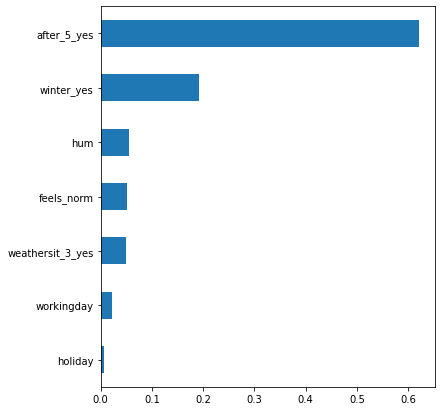

In [41]:
coef = pd.Series(model.feature_importances_, index = X.columns)
imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (6, 7)
imp_coef.plot(kind = "barh")

In [42]:
from tensorflow.keras.layers.experimental import preprocessing

features = np.array(X_train)

features_norm = preprocessing.Normalization(input_shape=[1,])

features_norm.adapt(features)

In [43]:
from keras.layers import LeakyReLU
leaky_relu_alpha = 0.1

model = Sequential([
    features_norm,
    layers.Dense(32, activation='relu'),
    layers.Dense(64, activation='relu'),
    layers.Dense(units=1)
])

#model.add(LeakyReLU(alpha=leaky_relu_alpha))

model.compile(loss='mse',
                optimizer=tf.keras.optimizers.Adam(0.001))

In [44]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
normalization (Normalization (None, 7)                 15        
_________________________________________________________________
dense (Dense)                (None, 32)                256       
_________________________________________________________________
dense_1 (Dense)              (None, 64)                2112      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 65        
Total params: 2,448
Trainable params: 2,433
Non-trainable params: 15
_________________________________________________________________


In [45]:
%%time

history = model.fit(X_train, y_train, validation_split=.2, batch_size=10, epochs=40, verbose=2)

Epoch 1/40
1113/1113 - 2s - loss: 28098.3066 - val_loss: 18930.7949
Epoch 2/40
1113/1113 - 1s - loss: 19177.6523 - val_loss: 18723.4629
Epoch 3/40
1113/1113 - 1s - loss: 19011.7988 - val_loss: 18391.0039
Epoch 4/40
1113/1113 - 1s - loss: 18904.4570 - val_loss: 18209.8984
Epoch 5/40
1113/1113 - 1s - loss: 18786.4727 - val_loss: 18220.6055
Epoch 6/40
1113/1113 - 1s - loss: 18662.8223 - val_loss: 18001.7871
Epoch 7/40
1113/1113 - 1s - loss: 18623.0859 - val_loss: 17936.8438
Epoch 8/40
1113/1113 - 1s - loss: 18593.0430 - val_loss: 17855.1914
Epoch 9/40
1113/1113 - 1s - loss: 18537.3574 - val_loss: 17810.2812
Epoch 10/40
1113/1113 - 1s - loss: 18502.8789 - val_loss: 18011.8711
Epoch 11/40
1113/1113 - 1s - loss: 18480.8730 - val_loss: 17755.8340
Epoch 12/40
1113/1113 - 1s - loss: 18491.4766 - val_loss: 17867.6035
Epoch 13/40
1113/1113 - 1s - loss: 18477.1719 - val_loss: 17758.9844
Epoch 14/40
1113/1113 - 1s - loss: 18430.7598 - val_loss: 17734.3691
Epoch 15/40
1113/1113 - 1s - loss: 18458.09

In [46]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_loss(history):
  plt.plot(history.history['loss'], label='loss')
  plt.plot(history.history['val_loss'], label='val_loss')
  plt.ylim([0, 40000])
  plt.xlabel('Epoch')
  plt.ylabel('Error [total_rented]')
  plt.legend()
  plt.grid(True)

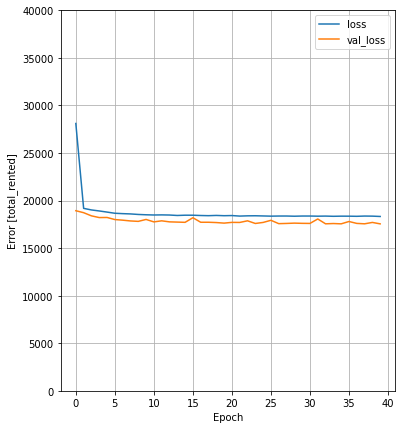

In [47]:
plot_loss(history)

In [48]:
from sklearn.metrics import mean_squared_error
preds = model.predict(X_test)


result = mean_squared_error(y_test, preds, squared=False)
result

134.79534079322852

In [49]:
X_test.shape

(3476, 7)

In [50]:
y_test.shape

(3476,)

In [51]:
from sklearn.metrics import mean_absolute_error

MAE = mean_absolute_error(y_test, preds)
print(MAE)

91.7079125529946


In [52]:
#loss = tf.keras.losses.mean_squared_error(y_test, preds)
#loss

In [53]:
"""
model2 = Sequential([
    features_norm,
    layers.Dense(16, activation='relu'),
    layers.Dense(units=1)
])

model2.compile(loss='mean_absolute_error',
                optimizer=tf.keras.optimizers.Adam(0.001))
"""

"\nmodel2 = Sequential([\n    features_norm,\n    layers.Dense(16, activation='relu'),\n    layers.Dense(units=1)\n])\n\nmodel2.compile(loss='mean_absolute_error',\n                optimizer=tf.keras.optimizers.Adam(0.001))\n"

In [54]:
#%%time

#history2 = model2.fit(X_train, y_train, validation_split=.2, batch_size=10, epochs=30, verbose=2)

In [55]:
"""
def plot_loss(history):
  plt.plot(history.history['loss'], label='loss')
  plt.plot(history.history['val_loss'], label='val_loss')
  plt.ylim([0, 200])
  plt.xlabel('Epoch')
  plt.ylabel('Error [total_rented]')
  plt.legend()
  plt.grid(True)

plot_loss(history2)
"""

"\ndef plot_loss(history):\n  plt.plot(history.history['loss'], label='loss')\n  plt.plot(history.history['val_loss'], label='val_loss')\n  plt.ylim([0, 200])\n  plt.xlabel('Epoch')\n  plt.ylabel('Error [total_rented]')\n  plt.legend()\n  plt.grid(True)\n\nplot_loss(history2)\n"

In [56]:
#pred2 = model2.predict(X_test)

#MAE = mean_absolute_error(y_test, preds)
#print(MAE)

In [57]:
print(f'Mean: {bikes_ml.total_rented.mean()}')
print(f'Median: {bikes_ml.total_rented.median()}')
print(f'Min: {bikes_ml.total_rented.min()}')
print(f'Max: {bikes_ml.total_rented.max()}')

Mean: 189.46308763450142
Median: 142.0
Min: 1
Max: 977


In [58]:
import altair as alt

b_ikes = pd.read_csv('https://raw.githubusercontent.com/byui-cse/cse450-course/master/data/bikes.csv')

b_ikes["season_type"] = b_ikes.season.apply(get_season)

b_ikes["total_rented"] = b_ikes.casual + b_ikes.registered

alt.data_transformers.disable_max_rows()

alt.Chart(b_ikes).mark_boxplot().encode(
    x='season_type',
    y='total_rented:Q'
).properties(
    width =750
)

alt.Chart(...)

In [59]:
from sklearn.model_selection import GridSearchCV
from keras.wrappers.scikit_learn import KerasClassifier


# Readying neural network model
def build_cnn(activation = 'relu',dropout_rate = 0.2, optimizer = 'Adam'):

  model3 = Sequential([
                       features_norm,
                       layers.Dense(32, activation='relu'),
                       layers.Dense(64, activation='relu'),
                       layers.Dense(units=1)
  ])

  model3.compile(loss='mse', optimizer=tf.keras.optimizers.Adam(0.001), metrics=["accuracy"])

  return model3



In [60]:
model = KerasClassifier(build_fn=build_cnn, verbose=0)
# define the grid search parameters
batch_size = [10, 20, 30]
epochs = [20, 30, 50]
param_grid = dict(batch_size=batch_size, epochs=epochs)
grid = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=3)
grid_result = grid.fit(X_train, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.012947 using {'batch_size': 10, 'epochs': 20}
0.012947 (0.001506) with: {'batch_size': 10, 'epochs': 20}
0.012947 (0.001399) with: {'batch_size': 10, 'epochs': 30}
0.012947 (0.001271) with: {'batch_size': 10, 'epochs': 50}
0.012875 (0.001147) with: {'batch_size': 20, 'epochs': 20}
0.012803 (0.001335) with: {'batch_size': 20, 'epochs': 30}
0.012803 (0.001200) with: {'batch_size': 20, 'epochs': 50}
0.012875 (0.001414) with: {'batch_size': 30, 'epochs': 20}
0.012659 (0.001520) with: {'batch_size': 30, 'epochs': 30}
0.012803 (0.001200) with: {'batch_size': 30, 'epochs': 50}


In [61]:
model = KerasClassifier(build_fn=build_cnn, epochs=30, batch_size=200, verbose=0)
# define the grid search parameters
optimizer = ['SGD', 'RMSprop', 'Adagrad', 'Adadelta', 'Adam', 'Adamax', 'Nadam']
param_grid = dict(optimizer=optimizer)
grid = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=3)
grid_result = grid.fit(X_train, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.012803 using {'optimizer': 'RMSprop'}
0.012731 (0.001443) with: {'optimizer': 'SGD'}
0.012803 (0.001540) with: {'optimizer': 'RMSprop'}
0.012731 (0.001443) with: {'optimizer': 'Adagrad'}
0.012731 (0.001443) with: {'optimizer': 'Adadelta'}
0.012659 (0.001347) with: {'optimizer': 'Adam'}
0.012731 (0.001443) with: {'optimizer': 'Adamax'}
0.012731 (0.001443) with: {'optimizer': 'Nadam'}


In [62]:
from keras.optimizers import SGD

def create_model(learn_rate=0.01, momentum=0):
  model = Sequential()
  model.add(layers.Dense(32, activation='relu'))
  model.add(layers.Dense(32, activation='relu'))
  model.add(layers.Dense(units=1))
  optimizer = SGD(lr=learn_rate, momentum=momentum)
  model.compile(loss='mse', optimizer=optimizer, metrics=['accuracy'])
  return model


model = KerasClassifier(build_fn=create_model, epochs=30, batch_size=20, verbose=0)
# define the grid search parameters
learn_rate = [0.001, 0.01, 0.1, 0.2, 0.3]
momentum = [0.0, 0.2, 0.4, 0.6, 0.8, 0.9]
param_grid = dict(learn_rate=learn_rate, momentum=momentum)
grid = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=3)
grid_result = grid.fit(X_train, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.012731 using {'learn_rate': 0.001, 'momentum': 0.2}
0.011077 (0.000887) with: {'learn_rate': 0.001, 'momentum': 0.0}
0.012731 (0.001443) with: {'learn_rate': 0.001, 'momentum': 0.2}
0.012731 (0.001443) with: {'learn_rate': 0.001, 'momentum': 0.4}
0.012731 (0.001443) with: {'learn_rate': 0.001, 'momentum': 0.6}
0.012731 (0.001443) with: {'learn_rate': 0.001, 'momentum': 0.8}
0.012731 (0.001443) with: {'learn_rate': 0.001, 'momentum': 0.9}
0.008847 (0.000982) with: {'learn_rate': 0.01, 'momentum': 0.0}
0.008847 (0.000982) with: {'learn_rate': 0.01, 'momentum': 0.2}
0.010070 (0.000886) with: {'learn_rate': 0.01, 'momentum': 0.4}
0.008847 (0.000982) with: {'learn_rate': 0.01, 'momentum': 0.6}
0.010070 (0.000886) with: {'learn_rate': 0.01, 'momentum': 0.8}
0.010070 (0.000886) with: {'learn_rate': 0.01, 'momentum': 0.9}
0.008847 (0.000982) with: {'learn_rate': 0.1, 'momentum': 0.0}
0.008847 (0.000982) with: {'learn_rate': 0.1, 'momentum': 0.2}
0.008847 (0.000982) with: {'learn_rate':

In [63]:
def create_model(activation='relu'):
  model = Sequential()
  model.add(layers.Dense(32, kernel_initializer='uniform', activation=activation))
  model.add(layers.Dense(64, kernel_initializer='uniform', activation=activation))
  model.add(layers.Dense(units=1, kernel_initializer='uniform'))
  model.compile(loss='mse', optimizer=tf.keras.optimizers.Adam(0.001), metrics=['accuracy'])
  return model


# create model
model = KerasClassifier(build_fn=create_model, epochs=30, batch_size=20, verbose=0)
# define the grid search parameters
activation = ['softmax', 'softplus', 'softsign', 'relu', 'tanh', 'sigmoid', 'hard_sigmoid', 'linear']
param_grid = dict(activation=activation)
grid = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=3)
grid_result = grid.fit(X_train, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.012947 using {'activation': 'tanh'}
0.012731 (0.001443) with: {'activation': 'softmax'}
0.012731 (0.001443) with: {'activation': 'softplus'}
0.012372 (0.001666) with: {'activation': 'softsign'}
0.012731 (0.001443) with: {'activation': 'relu'}
0.012947 (0.001616) with: {'activation': 'tanh'}
0.012731 (0.001443) with: {'activation': 'sigmoid'}
0.012731 (0.001443) with: {'activation': 'hard_sigmoid'}
0.012300 (0.002661) with: {'activation': 'linear'}


In [64]:
alt.data_transformers.disable_max_rows()

chart = alt.Chart(bikes).mark_boxplot().encode(
    alt.X('hum', title='Humidity'),
    alt.Y('total_rented:Q', title= 'Total Rented')
).properties(
    width =750
)
chart + chart.transform_loess('hum', 'total_rented').mark_line(color='red')

alt.LayerChart(...)